In [6]:
import pandas as pd
import numpy as np
import pywt
import matplotlib.pyplot as plt

data=np.load("subdata.npy")


In [7]:
# import libraries for plotting isosurfaces
import plotly.graph_objs as go
# utility for clearing output of cell as loop runs in notebook
from IPython.display import clear_output

# plot the data in time 

L = 10; # length of spatial domain (cube of side L = 2*10)
N_grid = 64; # number of grid points/Fourier modes in each direction
xx = np.linspace(-L, L, N_grid+1) #spatial grid in x dir
x = xx[0:N_grid]
y = x # same grid in y,z direction
z = x

data=np.reshape(data,(N_grid,N_grid,N_grid,49))

kx = (2*np.pi/(2*L))*np.linspace(-N_grid/2, N_grid/2 -1, N_grid) # frequency grid for one coordinate
ky=kx
kz=kx

Kx,Ky,Kz=np.meshgrid(kx,ky,kz)

xv, yv, zv = np.meshgrid( x, y, z) # generate 3D meshgrid for plotting

In [4]:
ff=0
for i in range(49):
  ff+=np.fft.fftshift(np.fft.fftn(data[:,:,:,i]))
ff=ff/49
ff_max=np.abs(ff).max()
normff=np.abs(ff)/ff_max
index=np.where(np.abs(ff)==ff_max)


sigma=2
gaussian_filter=np.exp(-((Kx-kx[int(index[1])])**2+(Ky-ky[int(index[0])])**2+(Kz-kz[int(index[2])])**2)/(2*sigma**2))


In [21]:
fig_data1=go.Isosurface(x=xv.flatten(),y=yv.flatten(),z=zv.flatten(),value=np.abs(normff).flatten(),isomin=0.7,isomax=0.7)
fig1=go.Figure(data=fig_data1)
fig1.update_layout(
    autosize=False,
    width=800,
    height=800)
fig1.show()

In [8]:
locations_in_time=[]
for _ in range(49):
  fft=np.fft.fftshift(np.fft.fftn(data[:,:,:,_]))
  fft_clean=fft*gaussian_filter
  f=np.fft.ifftn(np.fft.ifftshift(fft_clean))
  f_max=np.abs(f).max()
  index=np.where(np.abs(f)==f_max)
  locations_in_time.append(list(int(i) for i in index))



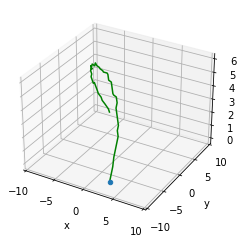

In [13]:
fig=plt.figure()
ax=plt.axes(projection='3d')
l=np.array(locations_in_time)
ax.plot3D(list(map(lambda i: x[i],l[:,1])),list(map(lambda i: x[i],l[:,0])),list(map(lambda i: x[i],l[:,2])),'green')
ax.scatter(x[l[0,1]],x[l[0,0]],x[l[0,2]])
#ax.plot3D(l[:,0],l[:,1],l[:,2],'green')
plt.xlim([-L, L])
plt.ylim([-L, L])
plt.xlabel('x')
plt.ylabel('y')
plt.show()

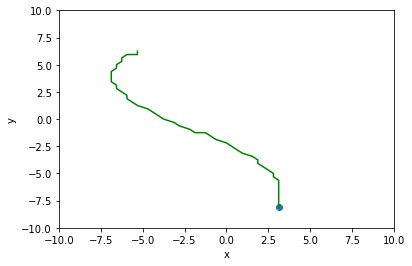

In [12]:
fig=plt.figure()
ax=plt.axes()
ax.plot(list(map(lambda i: x[i],l[:,1])),list(map(lambda i: x[i],l[:,0])),'green')
ax.scatter(x[l[0,1]],x[l[0,0]])
#ax.plot3D(l[:,0],l[:,1],l[:,2],'green')
plt.xlim([-L, L])
plt.ylim([-L, L])
plt.xlabel('x')
plt.ylabel('y')
plt.show()